In [2]:
""" 
Authors: Richard Chen, rachen@mit.edu; James Shaw, jshaw4@mit.edu; Eve Silfanus, eves@mit.edu

Much credit to this code is from the course 1.041: Transportation Foundations and Methods in Spring 2024.
"""

# import packages
import time
import math
import threading
import numpy as np

import matplotlib.pyplot as plt
import matplotlib

from PIL import Image, ImageDraw
import io

In [3]:
# IDM related parameters
# TO_DO Define parameter specifications of your IDM model and the IDM variant

T = 1 # desired time headway
a = 0.2 # comfortable acceleration (m/s^2)
b = 0.14 # comfortable deceleration (m/s^2)
s_0 = 0.5 # minimum spacing
v_0 = 0.5 # max velocity (m/s)
delta = 4 # exponent

In [4]:
robot_1_pos = 1.0 # starting position for robot 1 (m)
robot_1_vel = 0.0 # starting velocity for robot 1 (m)
robot_2_pos = 0.0 # starting position for robot 2 (m)
robot_2_vel = 0.0 # starting velocity for robot 2 (m)

dt = 0.1 # send a message every 0.1 seconds
total_time = 10 # 10 seconds
total_time_steps = int(total_time/dt) # run for 10 seconds

# generate a trajectory for robot 1
robot_1_accel_np = np.concatenate([np.repeat(0.2, int(3/dt)), np.repeat(-0.2, int(2/dt)), np.repeat(0.2, int(2/dt)), np.repeat(-0.2, int(3/dt))])

time_steps = np.arange(0, 10, 0.1)

In [5]:
def IDM_model():
    """ 
    Implementation of the Intelligent Driver Model (IDM) for car following. Calculates acceleration for the following vehicle.

    /* no longer in use at the moment
    Parameters 
    ----------
        dt: float
            time step
        vehicle_lead: float
            leading vehicle
        reference_position_x: float
            reference position on the roadmap
    */
    """

    # This is the net distance between the two vehicles (self and vehicle_lead)
    # (denoted as 's' in the lecture note)
    # use this value (in meters) instead of computing it.
    current_gap = robot_1_pos - robot_2_pos

    delta_v = robot_2_vel - robot_1_vel
    s_opt = s_0 + max(0, robot_2_vel*T + (robot_2_vel*delta_v)/(2*np.sqrt(a*b)))
    accel = a*(1-np.power((robot_2_vel/v_0),delta) - np.power((s_opt/current_gap),2))

    return accel

In [6]:
robot_1_pos_list = [robot_1_pos]
robot_1_vel_list = [robot_1_vel]
robot_2_pos_list = [robot_2_pos]
robot_2_vel_list = [robot_2_vel]
robot_2_accel_list = [0]

# run IDM model
for idx, time in enumerate(time_steps):

# # while time.time() - start_time < total_time:

#     # exit out once done
#     if idx >= float(total_time_steps):
#         break


#     if start_time + 0.1*idx < time.time():
    # compute acceleration
    robot_2_accel = IDM_model()

    # update position and velocity
    robot_1_pos = robot_1_pos + robot_1_vel*dt
    robot_1_vel = np.clip(robot_1_vel + robot_1_accel_np[int(idx)]*dt, 0, v_0)
    
    robot_2_pos = robot_2_pos + robot_2_vel*dt
    robot_2_vel = np.clip(robot_2_vel + robot_2_accel*dt, 0, v_0)

    # append updated values to list
    robot_1_pos_list.append(robot_1_pos)
    robot_1_vel_list.append(robot_1_vel)

    robot_2_pos_list.append(robot_2_pos)
    robot_2_vel_list.append(robot_2_vel)
    robot_2_accel_list.append(robot_2_accel)

# # stop the robots
# twist_robot1 = Twist()
# twist_robot1.linear.x = 0.0

# twist_robot2 = Twist()
# twist_robot2.linear.x = 0.0


In [7]:
# convert lists to numpy
robot_1_pos_np = np.array(robot_1_pos_list)
robot_1_vel_np = np.array(robot_1_vel_list)

robot_2_pos_np = np.array(robot_2_pos_list)
robot_2_vel_np = np.array(robot_2_vel_list)
robot_2_accel_np = np.array(robot_2_accel_list)

In [8]:
time_steps_extended = np.concatenate([time_steps, np.array([10])], axis=0)

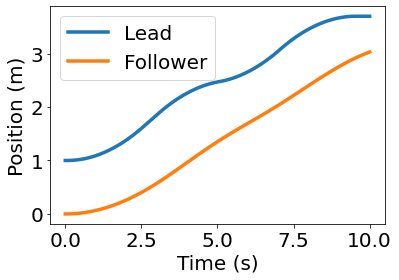

In [9]:
# position graph
matplotlib.rcParams.update({'font.size': 20})

fig, ax = plt.subplots()

ax.plot(time_steps_extended, robot_1_pos_np, label="Lead", linewidth=3.5)
ax.plot(time_steps_extended, robot_2_pos_np, label="Follower", linewidth=3.5)

ax.legend()

ax.set_xlabel("Time (s)")
ax.set_ylabel("Position (m)")

fig.savefig("Figures/position.png", dpi=200, bbox_inches='tight', facecolor="white")

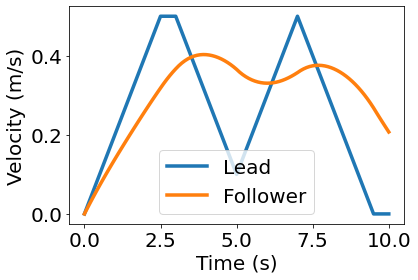

In [10]:
# velocity graph
matplotlib.rcParams.update({'font.size': 20})

fig, ax = plt.subplots()

ax.plot(time_steps_extended, robot_1_vel_np, label="Lead", linewidth=3.5)
ax.plot(time_steps_extended, robot_2_vel_np, label="Follower", linewidth=3.5)

ax.legend()

ax.set_xlabel("Time (s)")
ax.set_ylabel("Velocity (m/s)")

fig.savefig("Figures/velocity.png", dpi=200, bbox_inches='tight', facecolor="white")

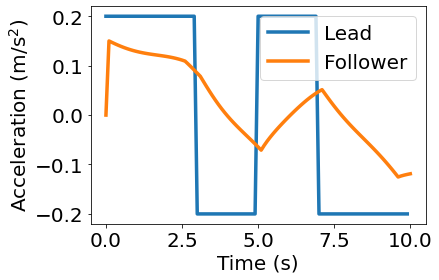

In [11]:
# acceleration graph
matplotlib.rcParams.update({'font.size': 20})

fig, ax = plt.subplots()

ax.plot(time_steps, robot_1_accel_np, label="Lead", linewidth=3.5)
ax.plot(time_steps_extended, robot_2_accel_np, label="Follower", linewidth=3.5)

ax.legend()

ax.set_xlabel("Time (s)")
ax.set_ylabel(r"Acceleration (m/s$^{2}$)")

fig.savefig("Figures/acceleration.png", dpi=200, bbox_inches='tight', facecolor="white")

In [12]:
def fig2img(fig):
    """ 
    Convert Matplotlib figure to Pillow Image.

    Parameters
    ----------
        fig: matplotlib.figure
            Matplotlib figure to convert.
    """
    
    buf = io.BytesIO()
    fig.savefig(buf)
    buf.seek(0)
    img = Image.open(buf)
    return img

/var/folders/rg/bxtcpc4x4nl7tghgvv14hrw40000gn/T/ipykernel_11670/1008275339.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


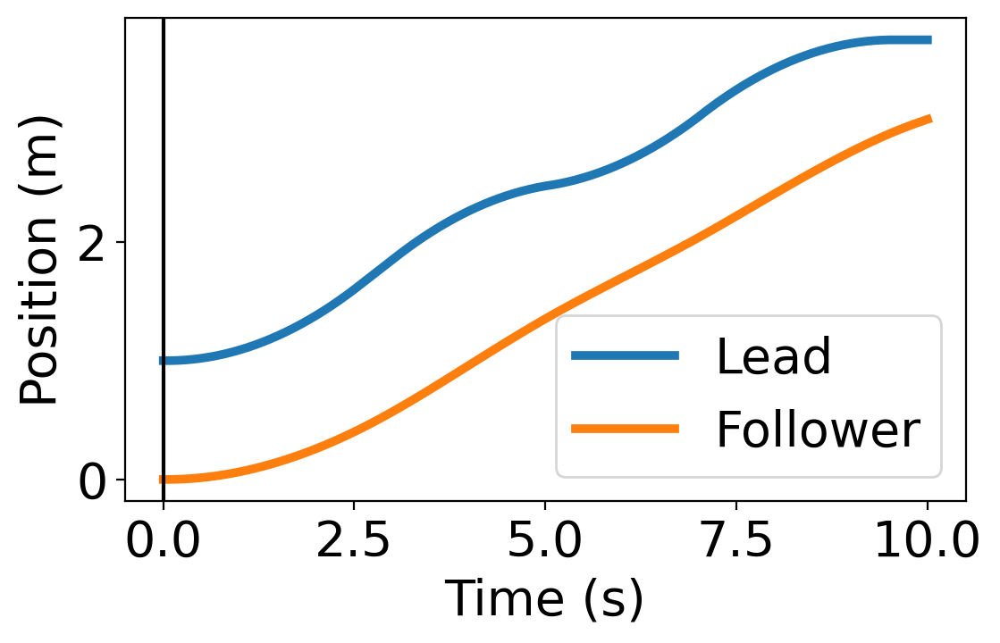

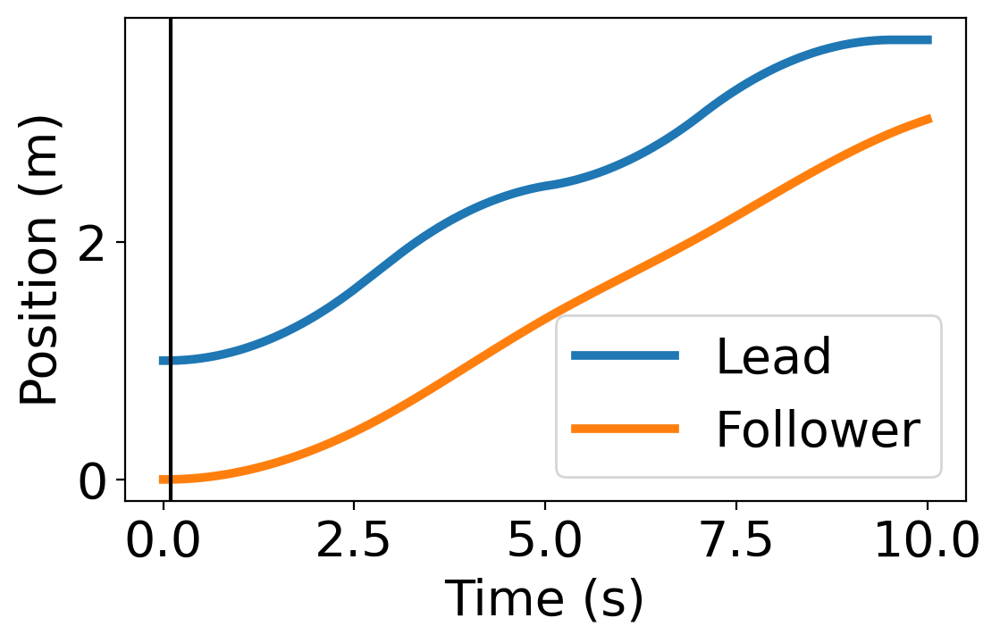

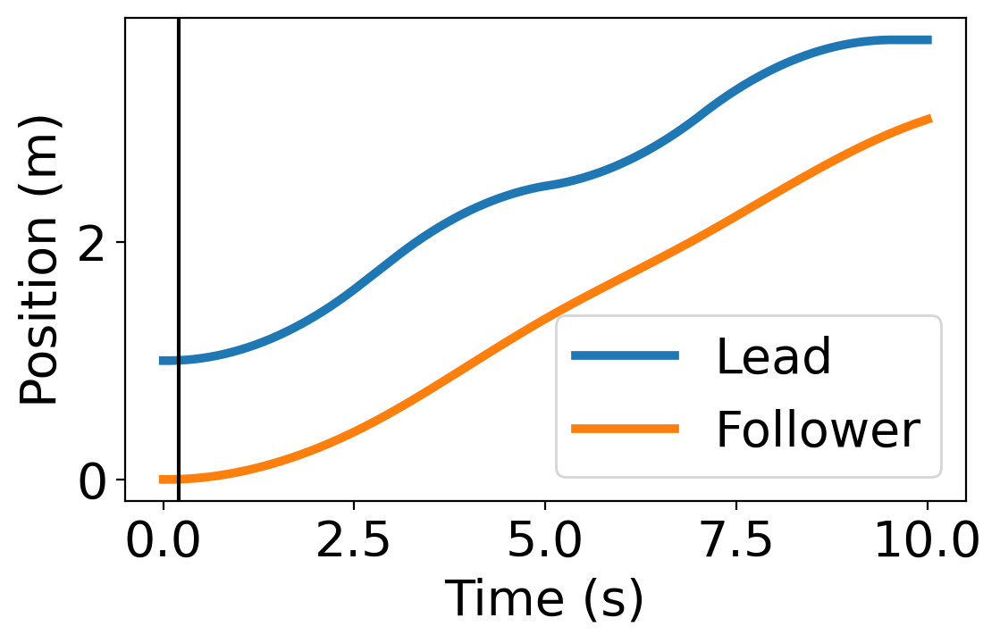

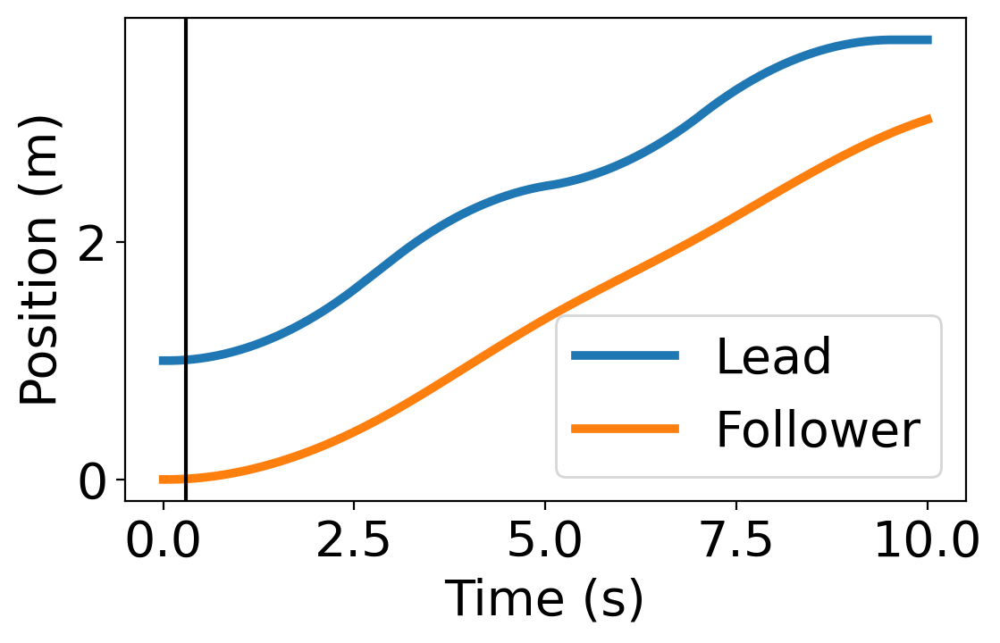

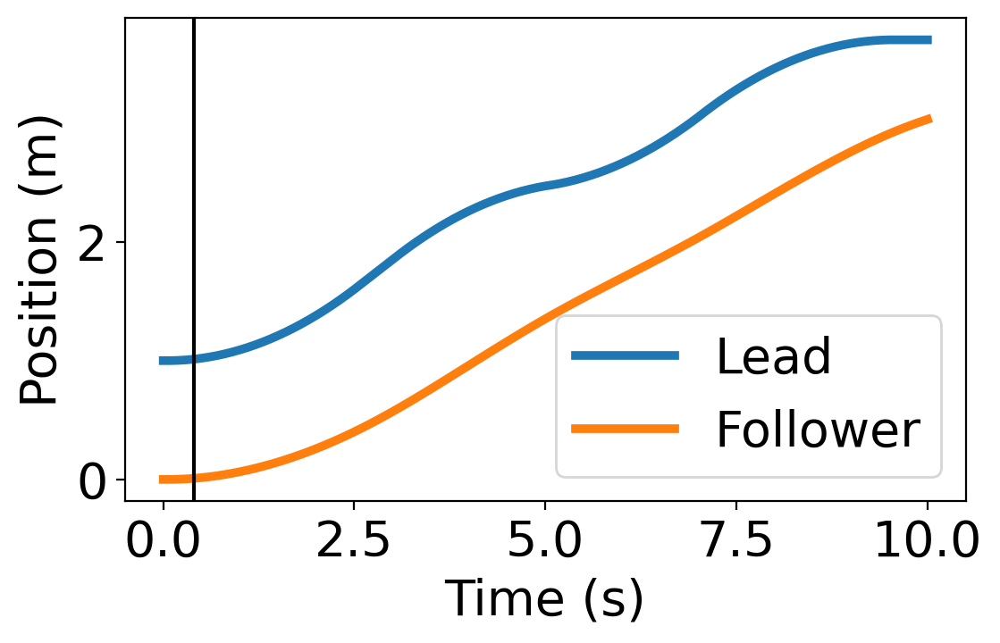

...

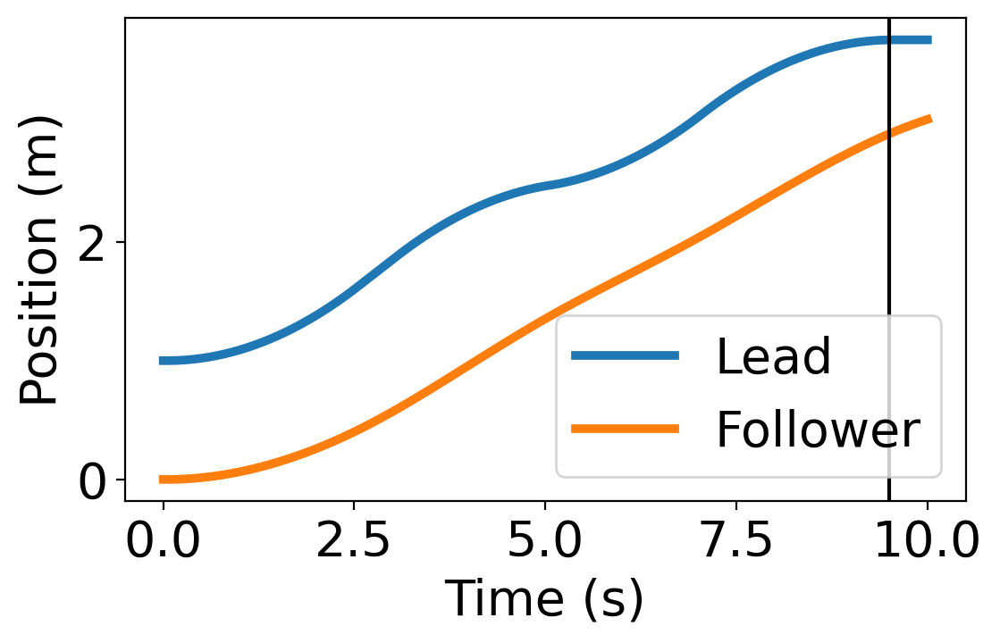

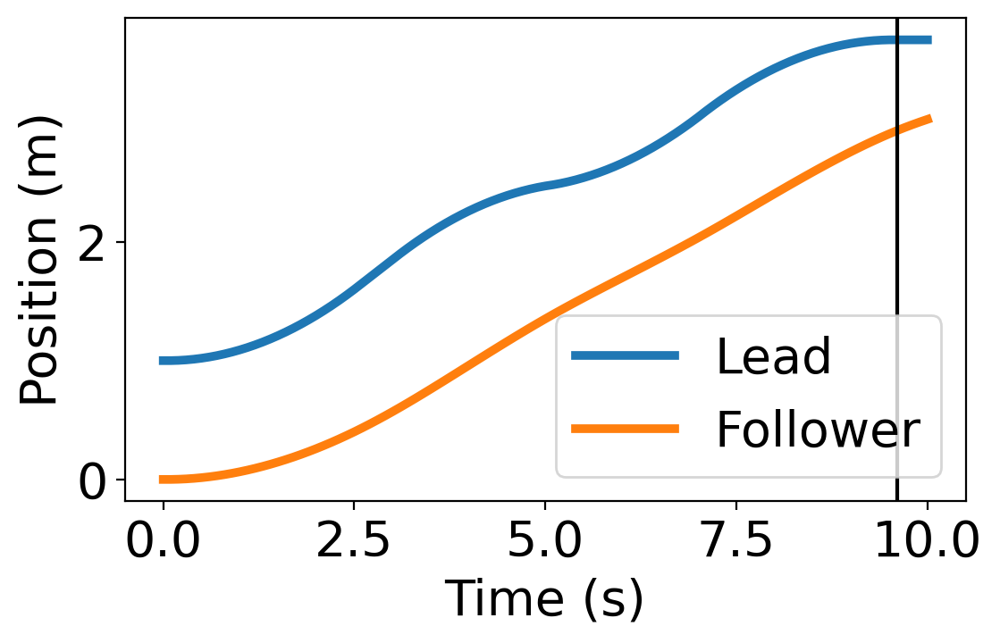

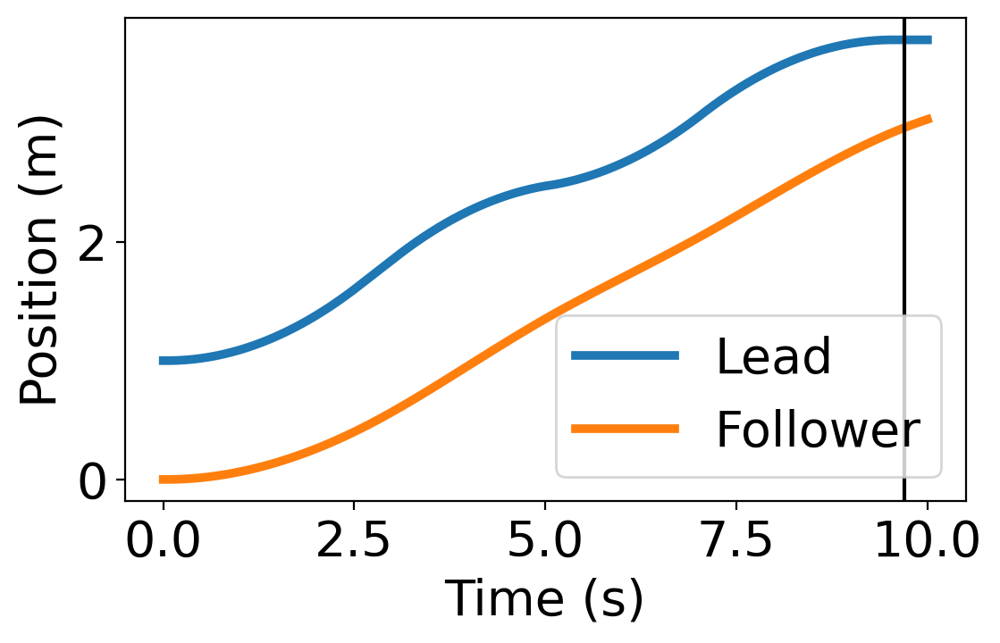

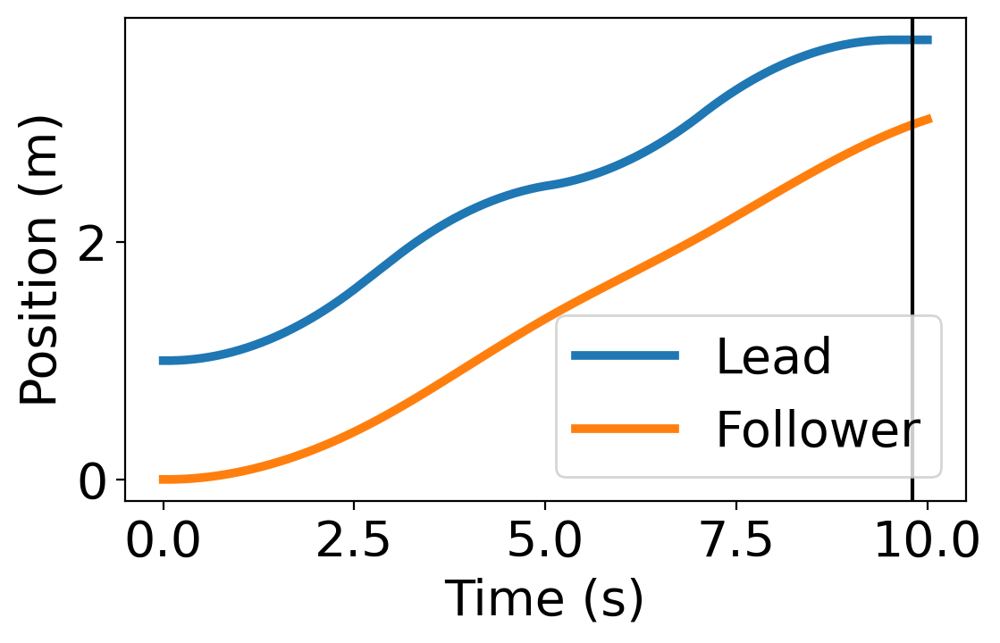

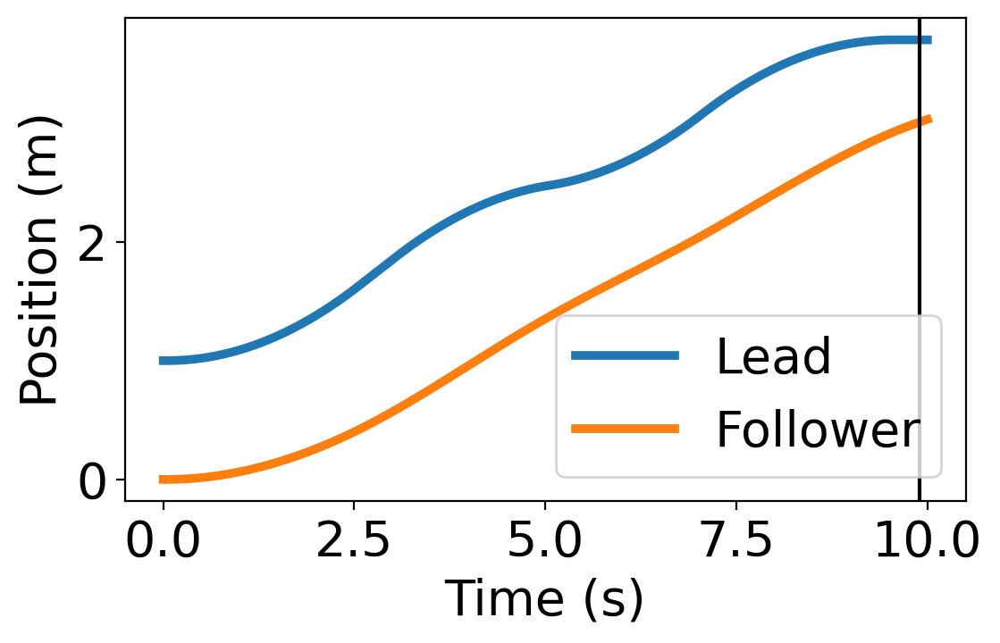

In [13]:
# code inspiration: https://towardsdatascience.com/animate-your-python-graphs-with-pillow-c1142b35c7f1/

matplotlib.rcParams['figure.dpi'] = 200

pos_gif = []

for idx, time_step in enumerate(time_steps):
    fig, ax = plt.subplots()

    ax.plot(time_steps_extended, robot_1_pos_np, label="Lead", linewidth=3.5)
    ax.plot(time_steps_extended, robot_2_pos_np, label="Follower", linewidth=3.5)

    ax.legend()

    ax.axvline(time_step, color="black")

    ax.set_xlabel("Time (s)")
    ax.set_ylabel("Position (m)")

    plt.tight_layout()

    img = fig2img(fig)
    pos_gif.append(img)

In [14]:
pos_gif[0].save('Figures/position.gif', save_all=True, append_images=pos_gif[1:], optimize=False, duration=100, loop=0)

/var/folders/rg/bxtcpc4x4nl7tghgvv14hrw40000gn/T/ipykernel_11670/2568650522.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


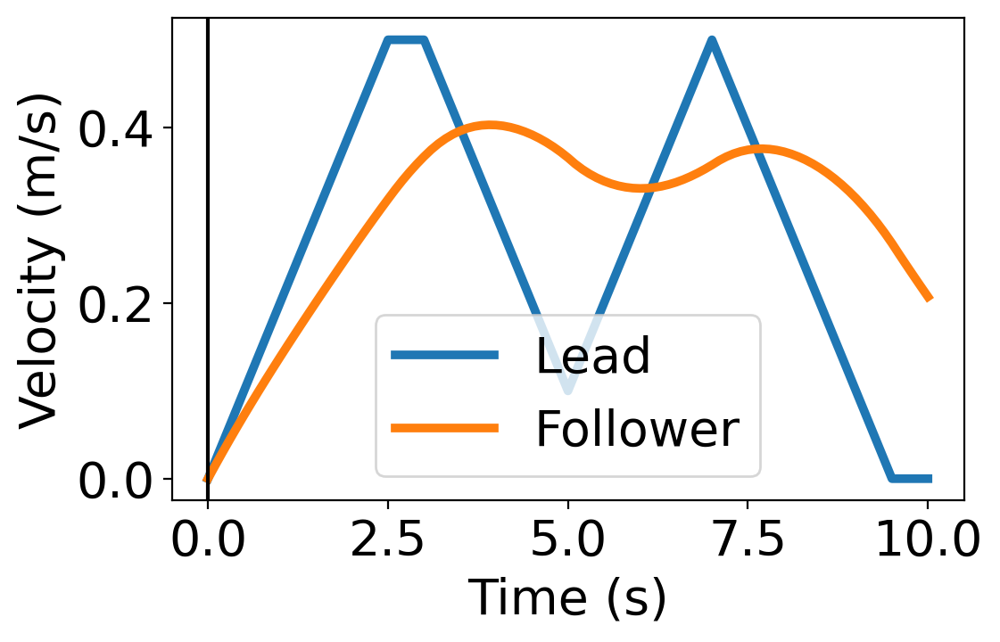

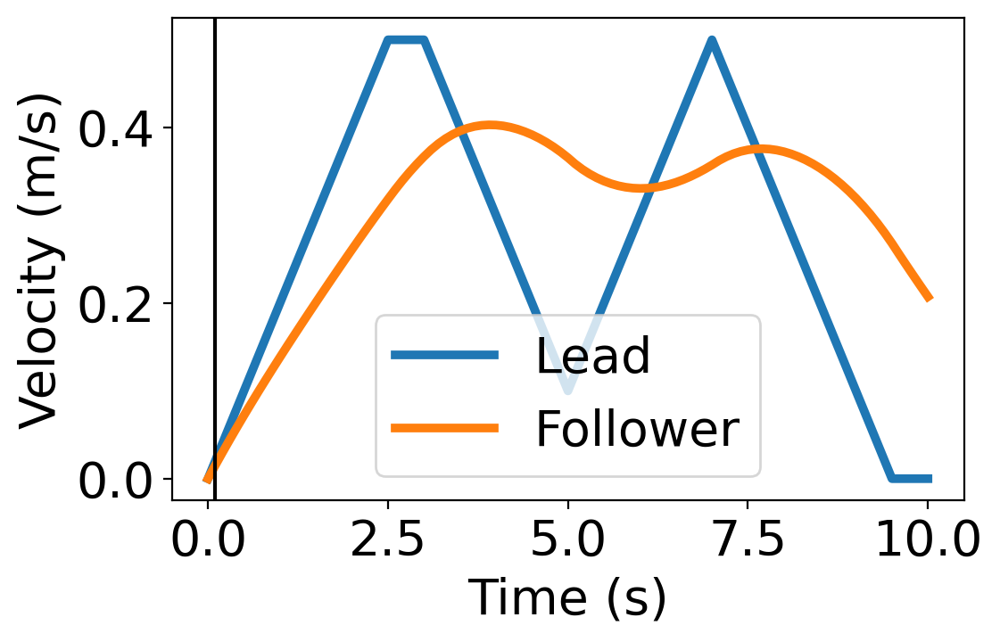

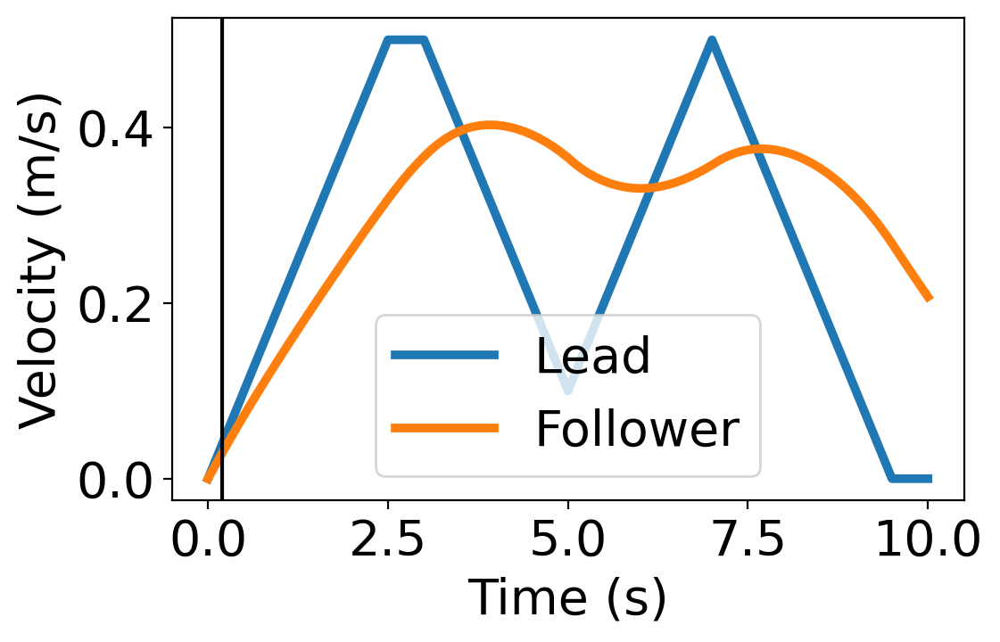

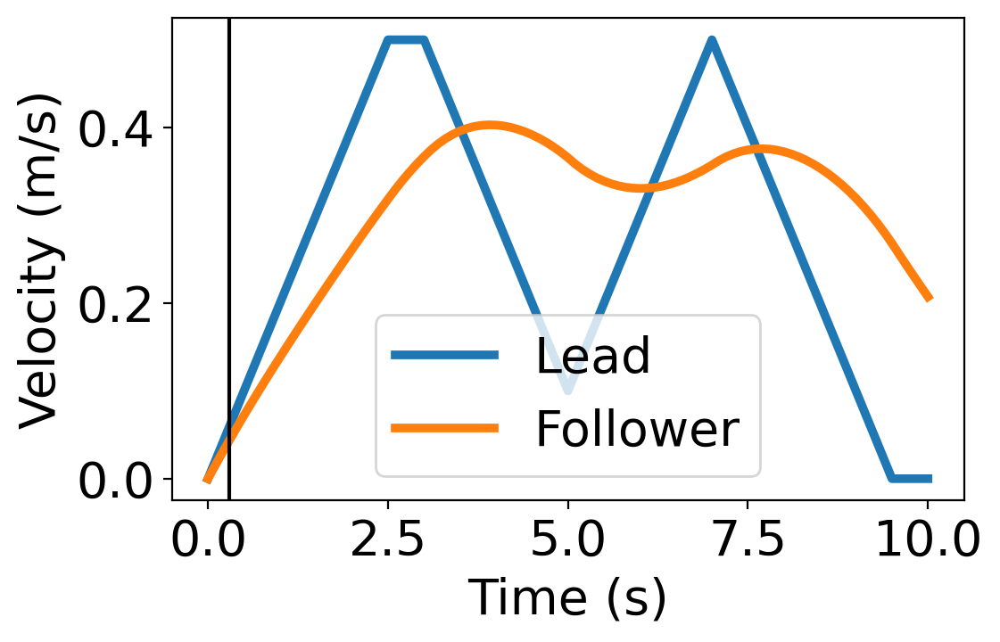

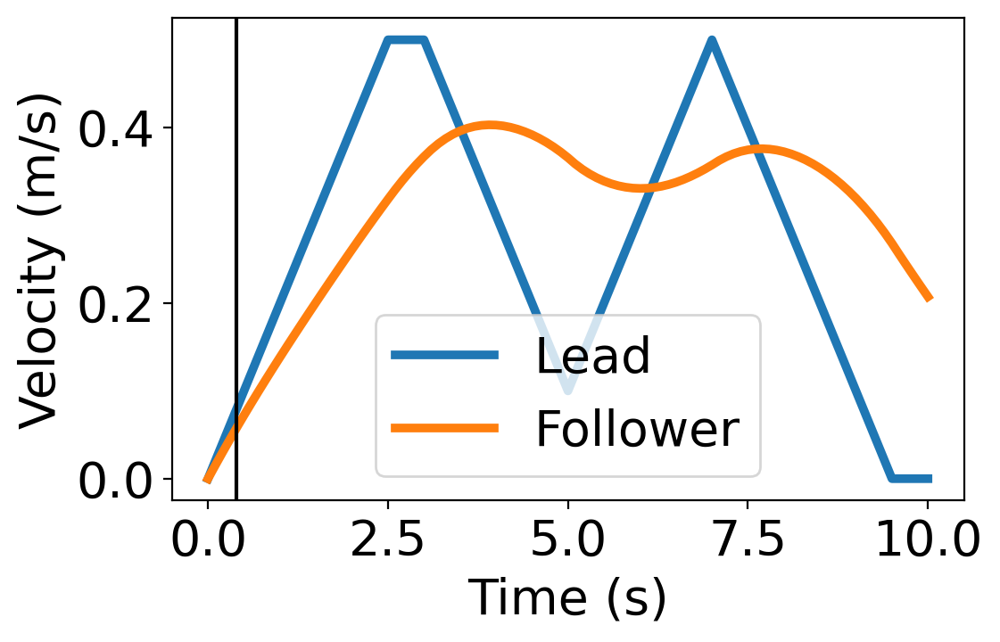

...

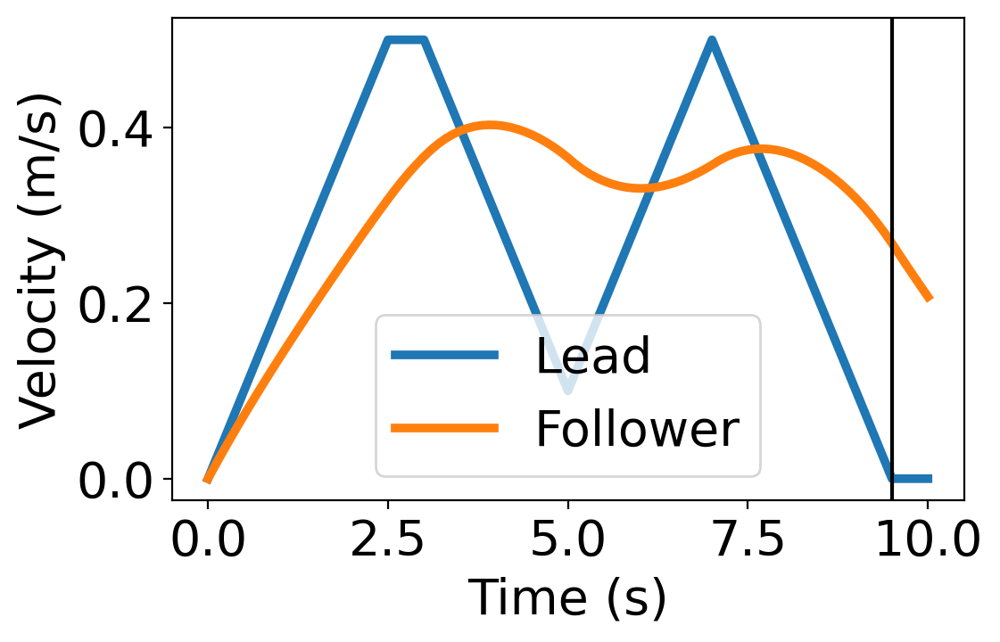

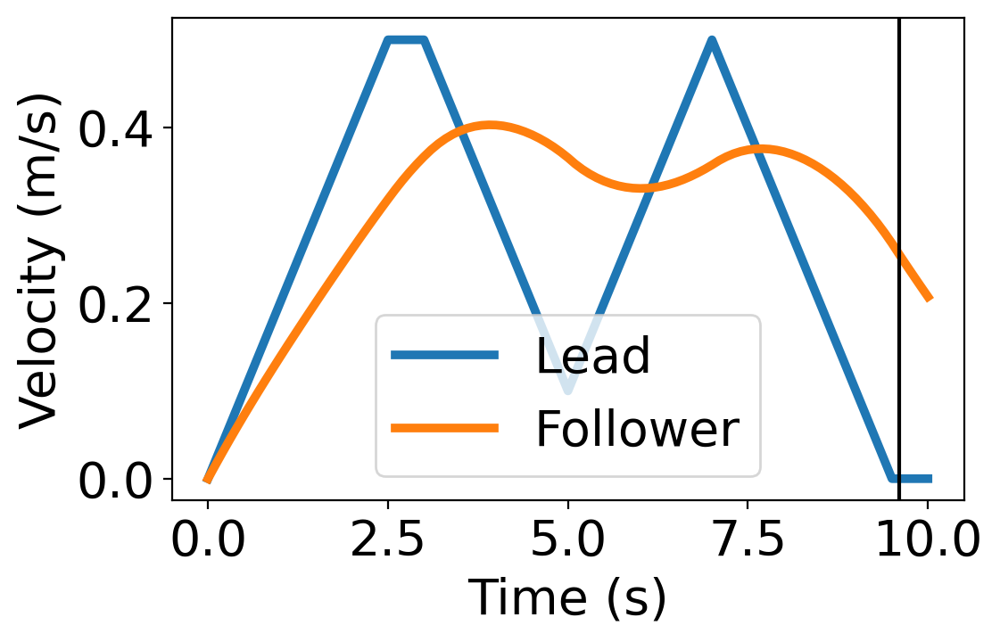

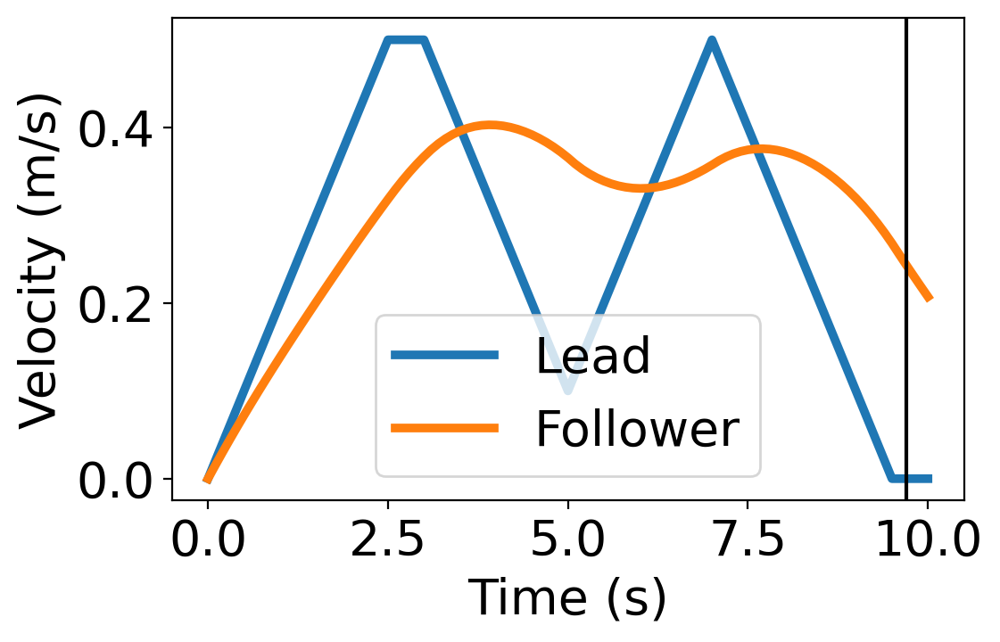

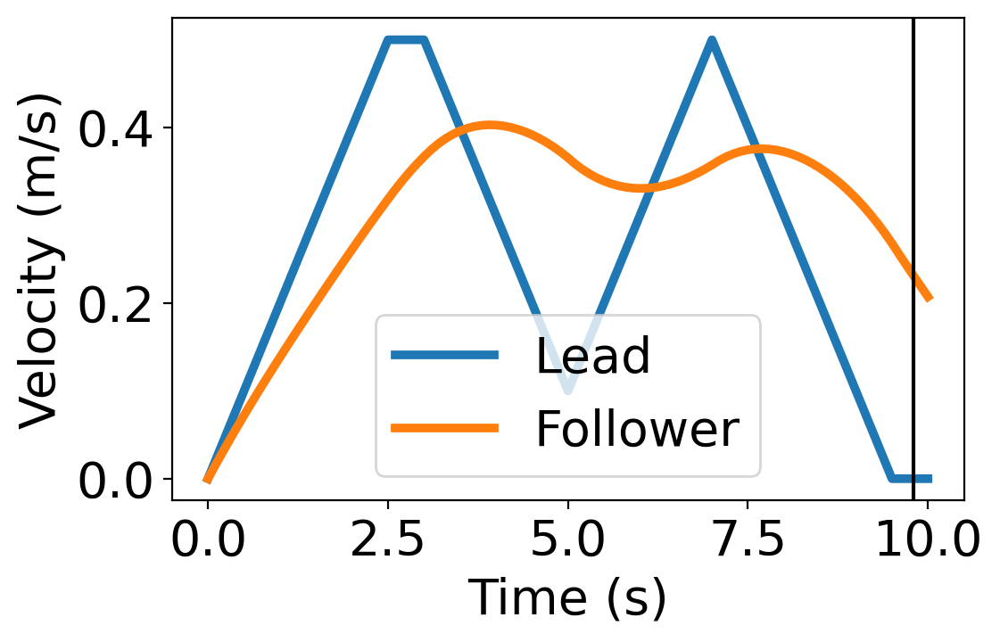

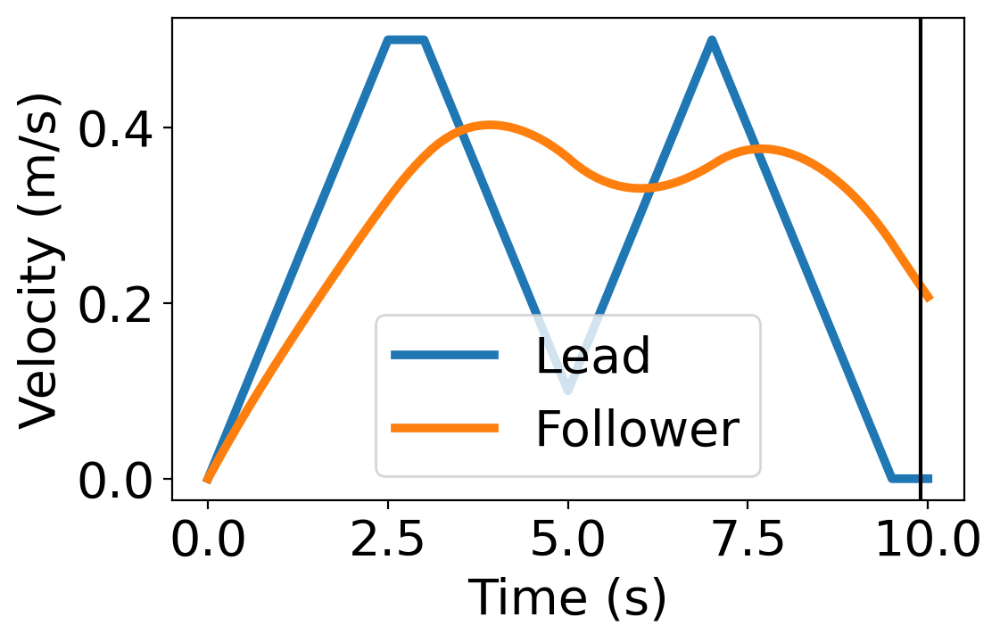

In [15]:
# code inspiration: https://towardsdatascience.com/animate-your-python-graphs-with-pillow-c1142b35c7f1/

matplotlib.rcParams['figure.dpi'] = 200

vel_gif = []

for idx, time_step in enumerate(time_steps):
    fig, ax = plt.subplots()

    ax.plot(time_steps_extended, robot_1_vel_np, label="Lead", linewidth=3.5)
    ax.plot(time_steps_extended, robot_2_vel_np, label="Follower", linewidth=3.5)

    ax.legend()

    ax.axvline(time_step, color="black")

    ax.set_xlabel("Time (s)")
    ax.set_ylabel("Velocity (m/s)")

    plt.tight_layout()

    img = fig2img(fig)
    vel_gif.append(img)

In [16]:
vel_gif[0].save('Figures/velocity.gif', save_all=True, append_images=vel_gif[1:], optimize=False, duration=100, loop=0)

/var/folders/rg/bxtcpc4x4nl7tghgvv14hrw40000gn/T/ipykernel_11670/3125991758.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


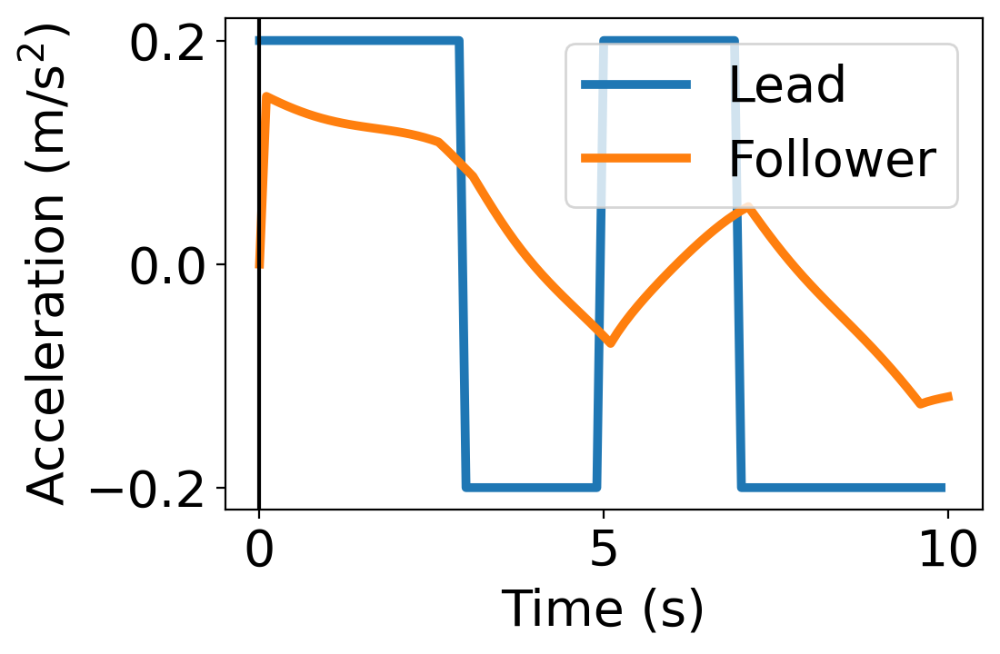

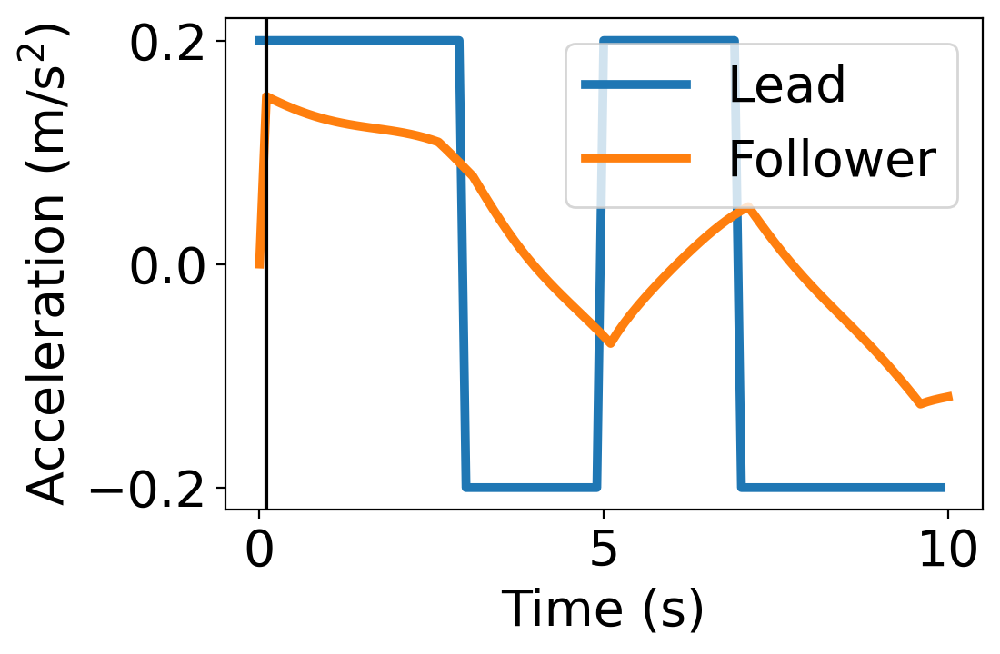

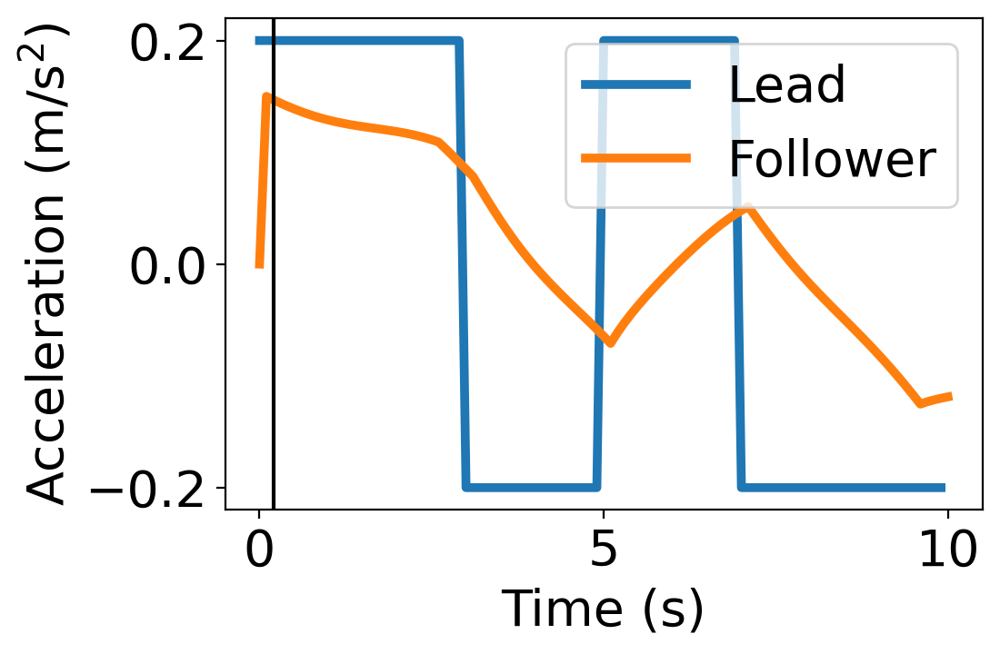

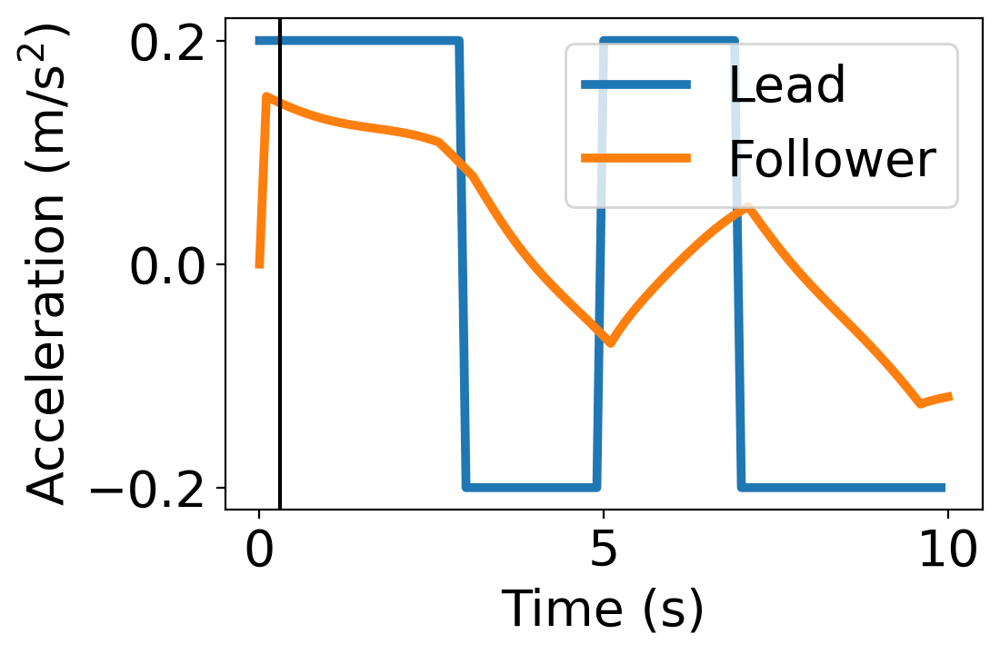

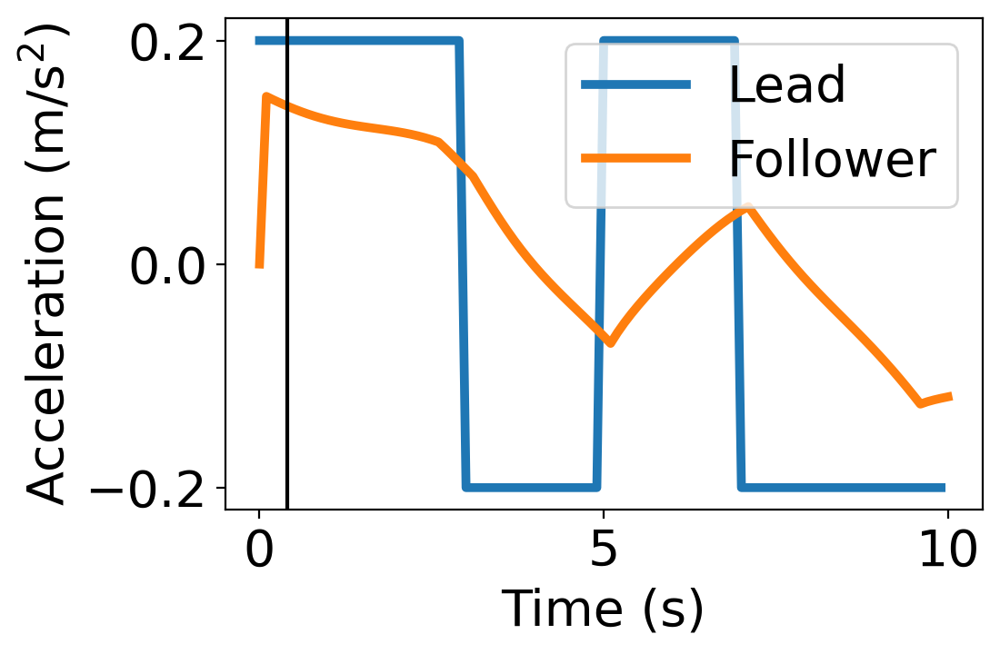

...

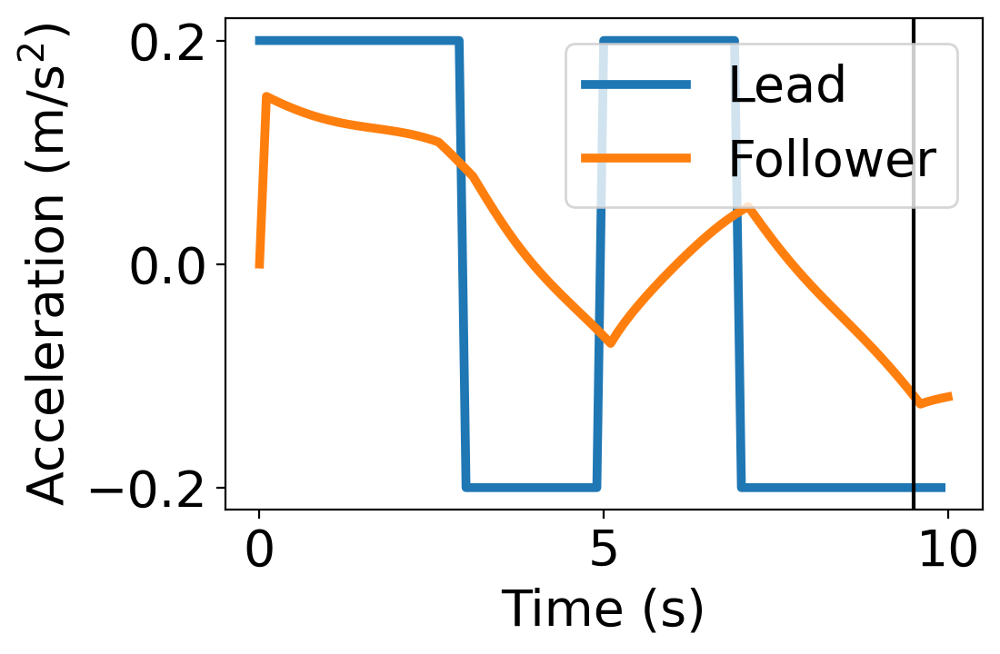

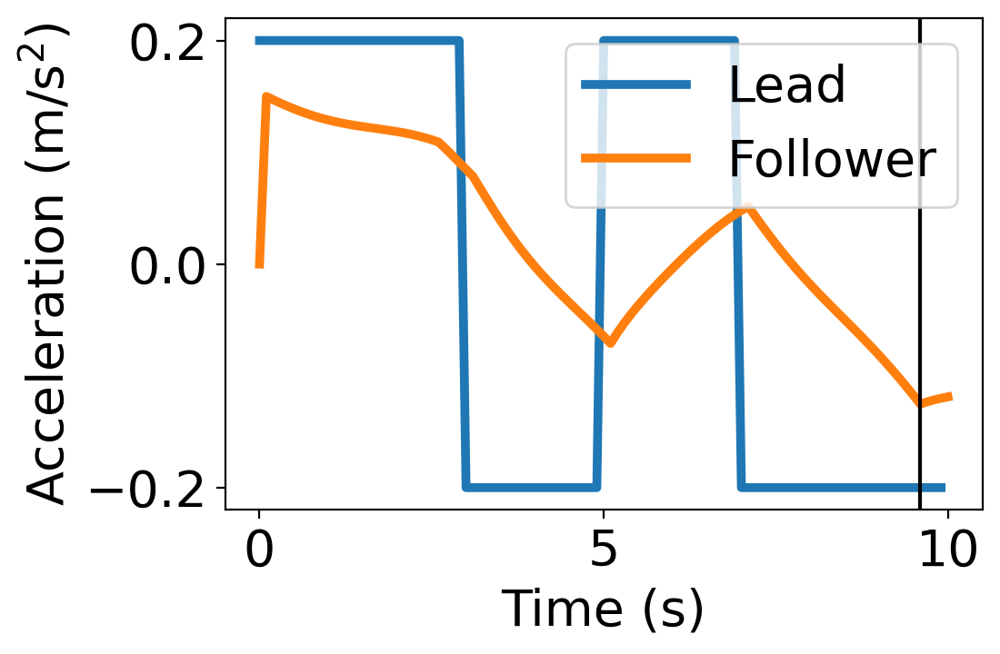

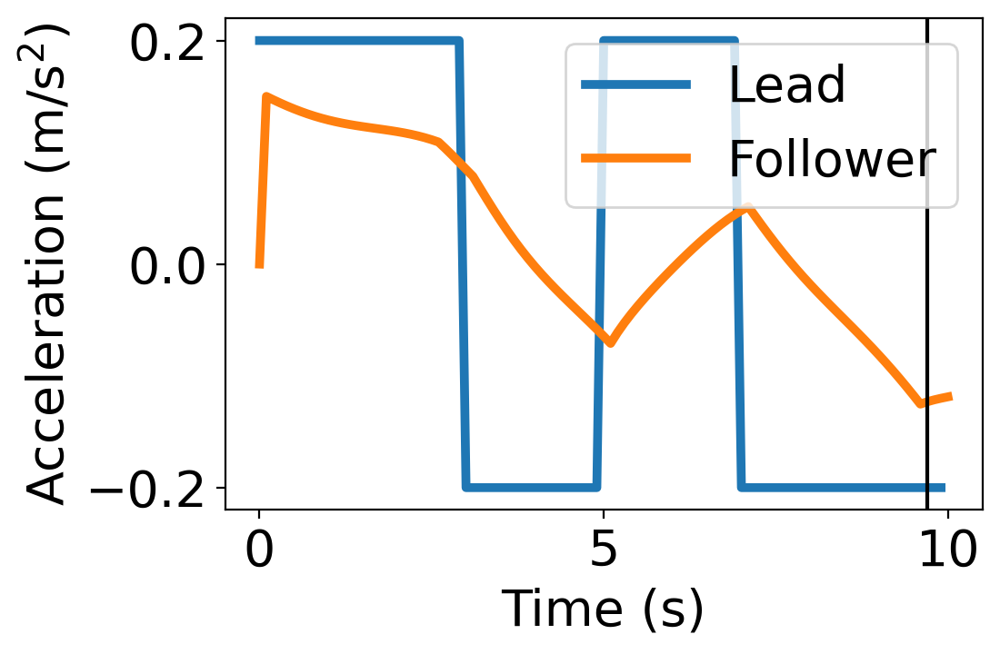

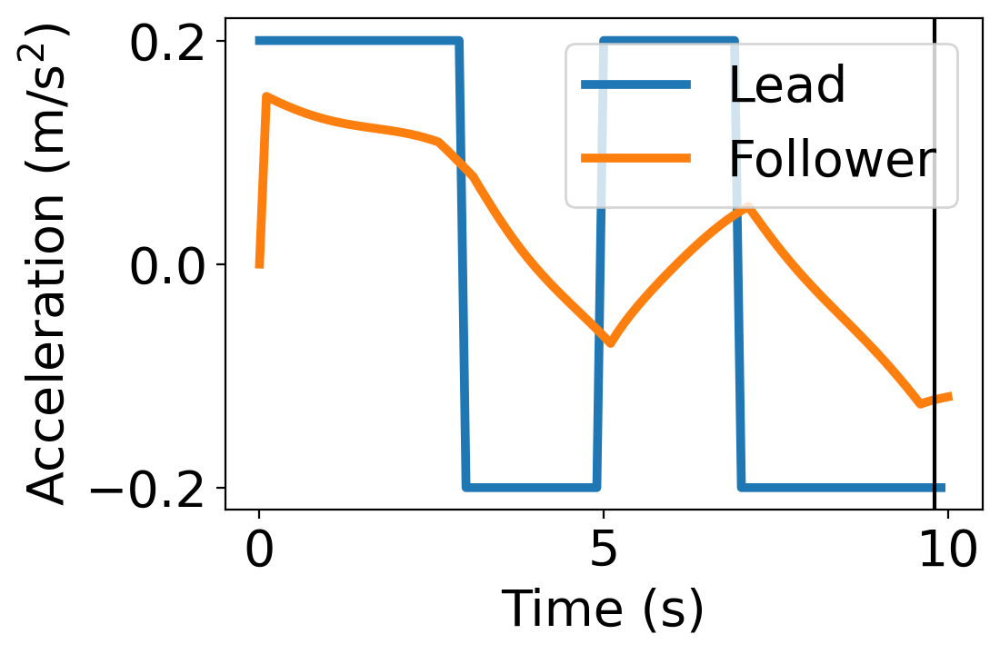

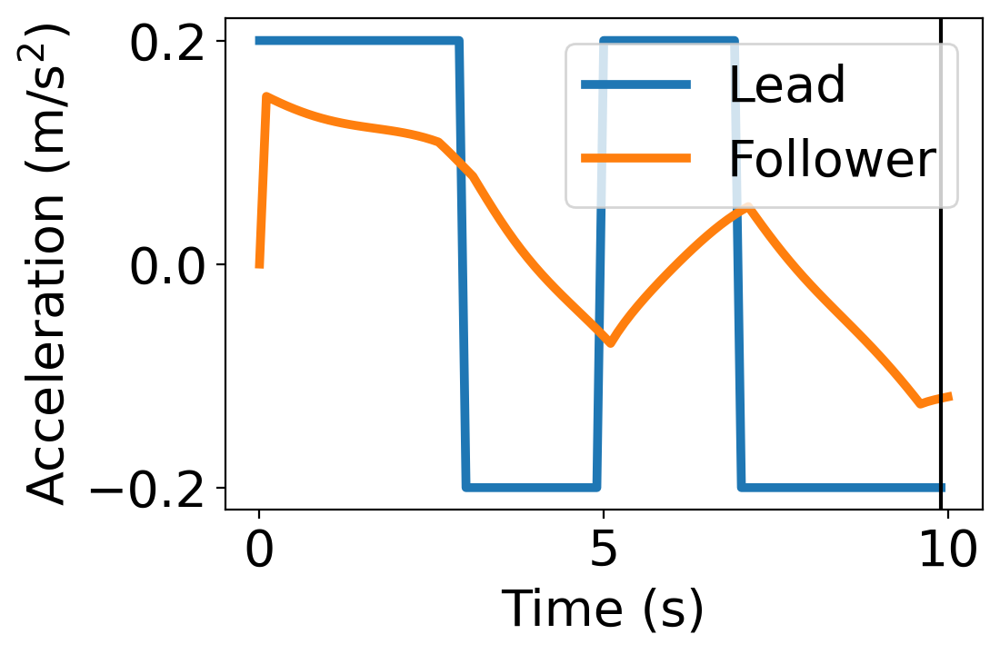

In [17]:
# code inspiration: https://towardsdatascience.com/animate-your-python-graphs-with-pillow-c1142b35c7f1/

matplotlib.rcParams['figure.dpi'] = 200

accel_gif = []

for idx, time_step in enumerate(time_steps):
    fig, ax = plt.subplots()

    ax.plot(time_steps, robot_1_accel_np, label="Lead", linewidth=3.5)
    ax.plot(time_steps_extended, robot_2_accel_np, label="Follower", linewidth=3.5)

    ax.legend()

    ax.axvline(time_step, color="black")

    ax.set_xlabel("Time (s)")
    ax.set_ylabel(r"Acceleration (m/s$^{2}$)")

    plt.tight_layout()

    img = fig2img(fig)
    accel_gif.append(img)

In [18]:
accel_gif[0].save('Figures/acceleration.gif', save_all=True, append_images=accel_gif[1:], optimize=False, duration=100, loop=0)